# Easy21 Task #2 & 3

Max Schrader

In [1]:
import numpy as np
from copy import copy, deepcopy
from random import random, choice, randint, uniform
import plotly.graph_objects as go

## Creating the Objects

### Cards

In [2]:
ACTIONS = {1: 'STICK', 0: 'HIT'}


class Cards:
    def __init__(self):
        self.distribution_range = (1, 10)

    def get_card(self, first=False):
        return randint(*self.distribution_range) * 1 if (uniform(0, 1) < 2 / 3) or first \
            else -1 * randint(*self.distribution_range)

### The Player

In [3]:
class Player:
    def __init__(self):
        self._cards = []
        self._sum = 0

    def check_bust(self):
        if self._sum < 1 or self._sum > 21:
            return True
        return False

    def clear_cards(self):
        self._cards = []
        self._sum = 0

    def add_card(self, card):
        self._cards.append(card)
        self._sum = sum(self._cards)

    def get_sum(self):
        return self._sum

    def get_card(self, index):
        return self._cards[index]

### The Dealer

In [4]:
class Dealer(Player):
    STICK_THRESHOLD = 17

    def __init__(self):
        super(Dealer, self).__init__()

    def play_strategy(self, card):
        self.add_card(card)
        if not self.check_bust():
            if self.get_sum() < self.STICK_THRESHOLD:
                return True
        return False

### The Observed State

In [5]:
class State:
    def __init__(self, player_sum, dealer_first):
        self.dealer_first = dealer_first
        self.player_sum = player_sum
        self.terminal = False

    def copy(self):
        return copy(self)

### The Game

In [6]:
class Easy21:

    def __init__(self, ):
        self.dealer = Dealer()
        self.player = Player()
        self.cards = Cards()
        self.states = [range(1, 11), range(1, 22)]
        self.actions = ACTIONS
        self.actions_short = list(range(len(self.actions.keys())))

    def reset(self):
        self.__init__()

    def initialize_game(self):
        self.dealer.clear_cards()
        self.player.clear_cards()
        self.dealer.add_card(self.cards.get_card(first=True))
        self.player.add_card(self.cards.get_card(first=True))
        s = State(self.player.get_sum(), self.dealer.get_card(0))
        return s

    def calc_reward(self):
        if self.dealer.check_bust() or (self.player.get_sum() > self.dealer.get_sum()):
            return 1
        elif self.player.get_sum() == self.dealer.get_sum():
            return 0
        return -1

    def step(self, action, state):
        state_1 = state.copy()
        if action == 1:
            while self.dealer.play_strategy(self.cards.get_card()):
                pass
            r = self.calc_reward()
            state_1.terminal = True
        else:
            card = self.cards.get_card()
            self.player.add_card(card)
            if self.player.check_bust():
                state_1.terminal = True
                r = -1
            else:
                state_1.player_sum = self.player.get_sum()
                r = 0
        return state_1, r

## Monte-Carlo Control in Easy21

In [7]:
class MonteCarloAgent:

    def __init__(self, gym: Easy21):
        self.gym = gym()
        self.Q = np.zeros((len(self.gym.states[1]), len(self.gym.states[0]), len(self.gym.actions_short)))
        self.N = deepcopy(self.Q)
        self.N0 = 100
        self.discount_factor = 1

    def calc_e(self, state: State) -> float:
        return self.N0 / (self.N0 + self.N[state.player_sum - 1, state.dealer_first - 1].sum() * 1.)

    def get_best_action(self, state):
        rewards = self.Q[state.player_sum - 1][state.dealer_first - 1]
        max_reward = max(rewards)
        return choice([self.gym.actions_short[i] for i, reward in enumerate(rewards) if reward >= max_reward])

    def e_greedy(self, state):
        e = self.calc_e(state)
        if random() < e:
            return choice(self.gym.actions_short)
        else:
            return self.get_best_action(state)

    def update_q(self, history):
        for i, (s_k, a_k, r_k) in enumerate(history):
            p_i = s_k.player_sum - 1
            d_i = s_k.dealer_first - 1
            G_t = sum([r_j * (self.discount_factor ** j) for j, (_, _, r_j) in enumerate(history[i:])])
            self.N[p_i, d_i, a_k] += 1
            alpha = 1.0 / self.N[p_i, d_i, a_k]
            self.Q[p_i, d_i, a_k] += alpha * (G_t - self.Q[p_i, d_i, a_k])

    def _train(self, ):
        self.gym.reset()
        s_t = self.gym.initialize_game()
        history = []
        while not s_t.terminal:
            a_t = self.e_greedy(s_t)
            s_t_1, r_t = self.gym.step(a_t, s_t)
            history.append([s_t, a_t, r_t])
            s_t = s_t_1
        self.update_q(history)

    def run(self, iterations, ):
        for _ in range(int(iterations)):
            self._train()

    def get_V_star(self, ):
        player_sum = list(self.gym.states[1])
        dealer_showing = list(self.gym.states[0])
        V_star = [[max(actions) for actions in dealer] for dealer in self.Q]
        return player_sum, dealer_showing, V_star

In [8]:
mc_agent = MonteCarloAgent(gym=Easy21, )

In [9]:
mc_agent.run(iterations=int(5e5))

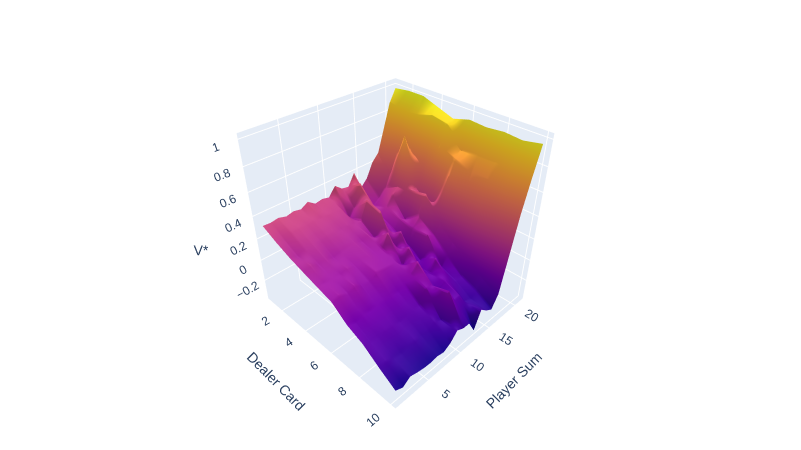

In [45]:
x, y, z = mc_agent.get_V_star()
fig = go.Figure(data=[go.Surface(z=z, x=y, y=x, showscale=False)])
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.5, y=-1.5, z=1.5)
)

fig.update_layout(scene_camera=camera, 
                  scene=dict(xaxis_title='Dealer Card', yaxis_title='Player Sum', zaxis_title="V*"), 
                             margin=dict(r=20, b=10, l=10, t=10))
fig.show()

## TD Learning in Easy21

In [11]:
class SARSAAgent(MonteCarloAgent):
    def __init__(self, gym, Q_star=None):
        super(SARSAAgent, self).__init__(gym)
        self.E = deepcopy(self.Q)
        self.Q_star = Q_star

    def _sarsa(self, _lambda, log_error):
        self.gym.reset()
        s_t = self.gym.initialize_game()
        a_t = self.e_greedy(s_t)
        self.N[s_t.player_sum - 1][s_t.dealer_first - 1][a_t] += 1
        a_t_1 = a_t
        while not s_t.terminal:
            s_t_1, r_t = self.gym.step(a_t, s_t)
            idx = (s_t.player_sum - 1, s_t.dealer_first - 1, a_t)
            Q_t = self.Q[idx]
            if not s_t_1.terminal:
                a_t_1 = self.e_greedy(s_t_1)
                idx_1 = (s_t_1.player_sum - 1, s_t_1.dealer_first - 1, a_t_1)
                self.N[idx_1] += 1
                Q_t_1 = self.Q[idx_1]
            else:
                Q_t_1 = 0
            d = r_t + (Q_t_1 - Q_t) * _lambda
            a = 1.0 / self.N[idx]
            self.E[idx] += 1
            self.Q += a * d * self.E
            self.E *= self.discount_factor * _lambda
            s_t = s_t_1
            a_t = a_t_1
        if log_error:
            return np.sum(np.square(self.Q_star - self.Q))
        return None

    def run(self, iterations, _lambda, log_error=False):
        error = []
        for i in range(iterations):
            if log_error:
                error.append((i, self._sarsa(_lambda, log_error)))
            self._sarsa(_lambda, log_error)
        if log_error:
            return error

### Testing the SARSA Agent

In [12]:
sarsa_agent = SARSAAgent(gym=Easy21, )

In [13]:
sarsa_agent.run(iterations=int(100000), _lambda=0.7)

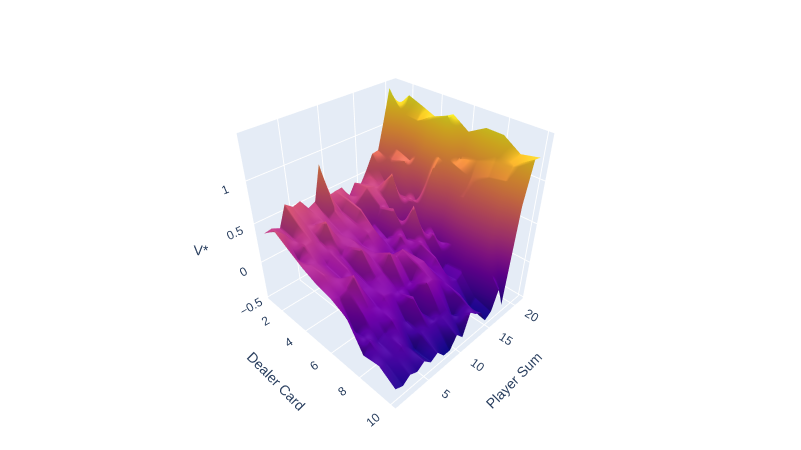

In [46]:
x, y, z = sarsa_agent.get_V_star()
fig = go.Figure(data=[go.Surface(z=z, x=y, y=x, showscale=False)])
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.5, y=-1.5, z=1.5)
)

fig.update_layout(scene_camera=camera, 
                  scene=dict(xaxis_title='Dealer Card', yaxis_title='Player Sum', zaxis_title="V*"), 
                             margin=dict(r=20, b=10, l=10, t=10))
fig.show()

### Finding the Sum-Squared Error with different lambdas

In [15]:
def calc_mean_error(mc_Q, sarsa_Q):
    return np.sum(np.square(mc_Q - sarsa_Q))

In [16]:
error = []
lambdas = [e * .1 for e in range(0, 11, 1)]
for _lambda in lambdas:
    sarsa_agent = SARSAAgent(gym=Easy21, )
    sarsa_agent.run(iterations=int(10000), _lambda=_lambda)
    error.append((_lambda, calc_mean_error(mc_agent.Q, sarsa_agent.Q)))
    print(_lambda, error[-1][-1])

0.0 588.6386833196361
0.1 318.6534863985606
0.2 241.39097523442945
0.30000000000000004 165.52956276692106
0.4 107.72860397472084
0.5 96.27422751926916
0.6000000000000001 72.01307007729869
0.7000000000000001 62.55595856144687
0.8 86.82151599696056
0.9 150.17320199280397
1.0 1230.8132566515444


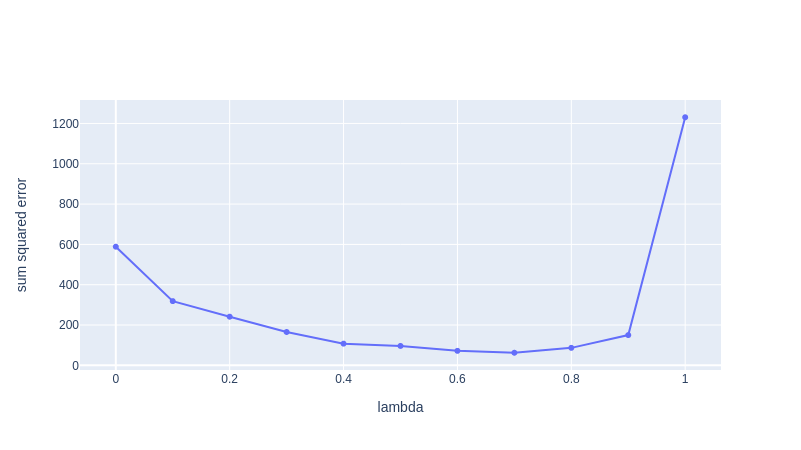

In [17]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=[e[0] for e in error], y=[e[1] for e in error]))
fig.update_layout(xaxis_title='lambda', yaxis_title='sum squared error')
fig.show()

I do not know why the error is so high with a lambda of 1. It is likely a bug in my code but I cannot trace it. Here it is plotted without 1:

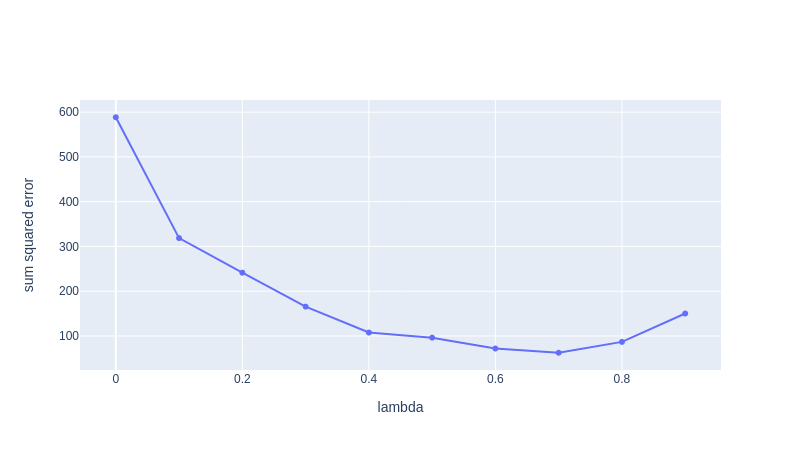

In [18]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=[e[0] for e in error[:-1]], y=[e[1] for e in error[:-1]]))
fig.update_layout(xaxis_title='lambda', yaxis_title='sum squared error')
fig.show()

### Plotting the error per episode for lambda = 0, 1

In [19]:
sarsa_agent = SARSAAgent(gym=Easy21, Q_star=mc_agent.Q)
zero_error = sarsa_agent.run(iterations=int(1e5), _lambda=0, log_error=True)

In [20]:
sarsa_agent = SARSAAgent(gym=Easy21, Q_star=mc_agent.Q)
one_error = sarsa_agent.run(iterations=int(1e5), _lambda=1, log_error=True)

In [21]:
sarsa_agent = SARSAAgent(gym=Easy21, Q_star=mc_agent.Q)
seven_error = sarsa_agent.run(iterations=int(1e5), _lambda=0.7, log_error=True)

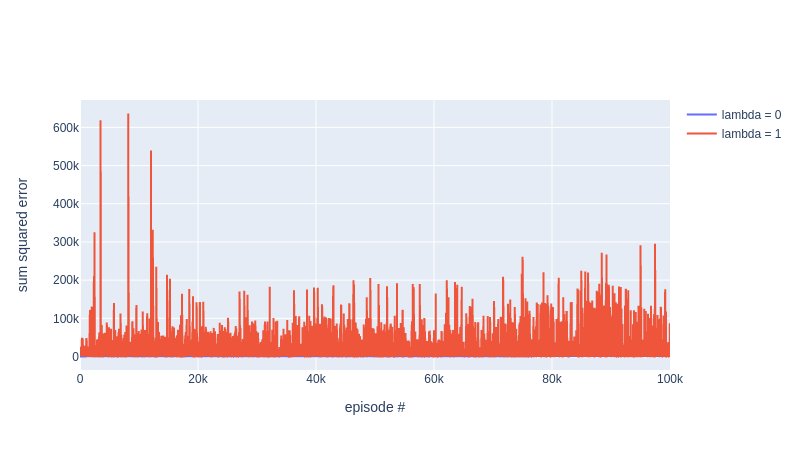

In [22]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=[e[0] for e in zero_error], y=[e[1] for e in zero_error], name="lambda = 0"))
fig.add_trace(go.Scatter(x=[e[0] for e in zero_error], y=[e[1] for e in one_error], name="lambda = 1"))
fig.update_layout(xaxis_title='episode #', yaxis_title='sum squared error')
fig.show()

Lambda = 1 is still a problem. Looking at the optimal lambda below:

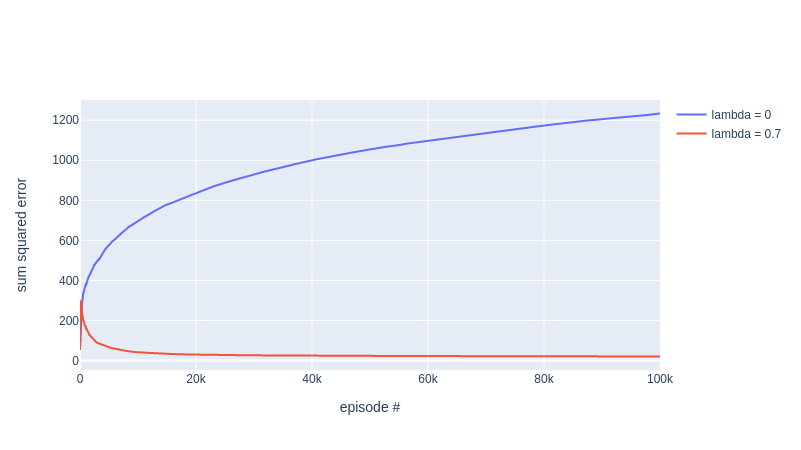

In [23]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=[e[0] for e in zero_error], y=[e[1] for e in zero_error], name="lambda = 0"))
fig.add_trace(go.Scatter(x=[e[0] for e in seven_error], y=[e[1] for e in seven_error], name="lambda = 0.7"))
fig.update_layout(xaxis_title='episode #', yaxis_title='sum squared error')
fig.show()